# Gateway Lesson


This is a PGC Data Workshop Gateway Lesson, which is your introduction to a foundational concept **_coregistration_** and key skills to model a glacier elevation change. This lesson prepares you for topics such as analysis of DEM accuracy, differnecing, and DEM coregistration. So with that said:

## Welcome to the Coregistration Exercise!

&#128512; 😀 &#128512; 😀


# DEM: Gridded Representations of Elevation

Digital Elevation Models (DEMs) serve as numerical, gridded representations of elevation, deriving from diverse instruments (e.g., optical sensors, radar, lidar). They are acquired under varying conditions, including ground, airborne, and satellite platforms, and are processed using different techniques like photogrammetry and remote sensing.

<div> <center>
<td><img src="img/An-example-of-a-Digital-Elevation-Model.png" width="800"/></td> </center>
</div>

> <span style="color:gray">
image source: Barcellos et al., 2007. Surface Flow Animation in Digital Terrain Models. </span>


## DEMs Have Complex Characteristics:

- **Ground Sampling Distance (GSD):** The pixel size, or GSD, doesn't always reflect the actual spatial resolution of the observations.

- **Georeferencing Challenges:** Georeferencing is prone to shifts, tilts, or deformations due to inherent instrument errors, noise, or associated processing schemes.

- **Outlier Abundance:** DEMs often contain numerous outliers that are challenging to filter, stemming from diverse sources like photogrammetric errors and cloud interference.

These factors contribute to the complexity of assessing the <b>accuracy</b> and <b>precision</b> of DEMs, a crucial step for any subsequent analysis.

<div> <center>
<td><img src="img/800px-Grancanaria-meshlab-vs-meshmixer.png" width="800"/></td> </center>
</div>

> <span style="color:gray">
    image source: edutechwiki.unige.ch </span>



## All DEMs Have Some Horizontal and Vertical Geolocation Error. 

The **spatial structure of DEMs** introduces complexity to the concepts of <b>accuracy</b> and <b>precision</b>. For example:

Spatially structured systematic errors are often associated with the gridded nature of DEMs, leading to affine biases. Additionally, specific biases can exist at the pixel scale. Concerning random errors, there is a variability in error magnitude or heteroscedasticity across the DEM, and spatially structured error patterns are connected to spatial correlations.


!["DEM"](img/Pattern_of_Errors.png)
>[ <span style="color:gray">
    image source: Hugonnet et al. (2022) </span>](https://ieeexplore.ieee.org/document/9815885) Source of errors in DEMs

## Optimizing DEM Accuracy in Relation to Other Georeferenced Data:

Shifts to the true positioning resulting from poor accuracy are common in elevation datasets and can be corrected effectively by performign a **DEM co-registration** with precise and accurate refrence elevation data that undergoes quality control. Quality-controlled DEMs, aligned to high-accuracy data, are also available, such as TanDEM-X global DEM (refer to [Rizzoli et al. (2017)](https://www.sciencedirect.com/science/article/pii/S092427161730093X?via%3Dihub)).

These biases can be addressed using the techniques outlined in **Coregistration**.
<br>
<br>
<center><table><tr>
<div>
<td><img src="img/Co1.png" width="400"/></td>
<td><img src="img/Co2.jpg" width="400"/></td>
</div>
</tr></table></center>

> <span style="color:gray">
    image source: Nuth and Kääb (2011) </span> 

## Coregistration

Coregistration aligns multiple datasets to a common reference, minimizing geometric differences. This involves adjusting the spatial parameters of one dataset to match those of another which: 

- may include transformations such as translation, rotation, scaling, and possibly more complex adjustments to account for distortions in the data.

- is often necessary when merging elevation data from various sources, such as satellite imagery, aerial photographs, LiDAR, or other remote sensing technologies. 

- each dataset may have been acquired at different times, from different platforms, or using different sensors, resulting in variations in spatial orientation, scale, and geometry.


## DEM Coregistration
Coregistration between DEMs correspond to aligning the digital elevation models in three dimensions.

Transformations that can be described by a 3-dimensional affine function are included in coregistration methods which include:

- vertical and horizontal translations

- rotations

- scalings


## Today's Workshop Focus: Greenland's Glacial DEMs

Greenland's Glacial DEMs change due to climate change, ice flow dynamics, iceberg calving, snow accumulation, and glacial surges. Having a reference DEM for coregistration in the region is crucial for accurately tracking elevation changes over time, enabling researchers to assess the impacts of climate change on glacier volume, ice flow velocities, and surface elevation. Coregistration facilitates the creation of time series datasets, aiding in the monitoring of long-term trends in glacier dynamics and ice loss.
<br>
<div><center>
<img src="img/elevChgLatLon_20_rainbowPurpleOrangeBright-3to3_large.png" width="800"/></center>
    
<center><img src="img/greenlandElevCbar.png" width="400" height="20" /></center>
</div>

> [<span style="color:gray">
    image source: NASA </span> ](https://svs.gsfc.nasa.gov/cgi-bin/details.cgi?aid=3410)


## Materials Required:

Two Digital Elevation Models (DEMs) of Greenland (can be obtained from different sources, e.g., NASA DEMs, ArcticDEM, etc.)

Jupyter Notebook with Python and relevant libraries (e.g., rasterio, geopandas, matplotlib)

# Install/Import Libraries:

Import necessary Python libraries for geospatial analysis by running the following cells (Shift+Enter).



In [1]:
# Import Python libraries
import matplotlib.pyplot as plt
import numpy as np
import folium
import rasterio
from tabulate import tabulate
from rasterio.warp import reproject, Resampling, calculate_default_transform
from rasterio.plot import show
from rasterio.warp import transform_bounds
from PIL import Image

# Load DEMs:

Load the two DEMs of Greenland using rasterio.


In [2]:
# Define DEM files
reference_dem_path  = 'DEM/TDX_Greenland_Iceland_Mosaic_90m_Sample.tif'
target_dem_path  = 'DEM/SETSM_s2s041_WV02_20150402_103001003E9F4300_103001004013BE00_2m_seg1_dem_10m.tif'

DEMs do not align with each other:
<div><center>
<img src="img/Resampling0.png" width="600"/>
</div>

> <span style="color:gray">
    image source: Slide.org </span> 


# Check Alignment of the DEMs:

Interact with DEM layers at pixel level. Zoom, pan, and toggle the visibility of each layer.




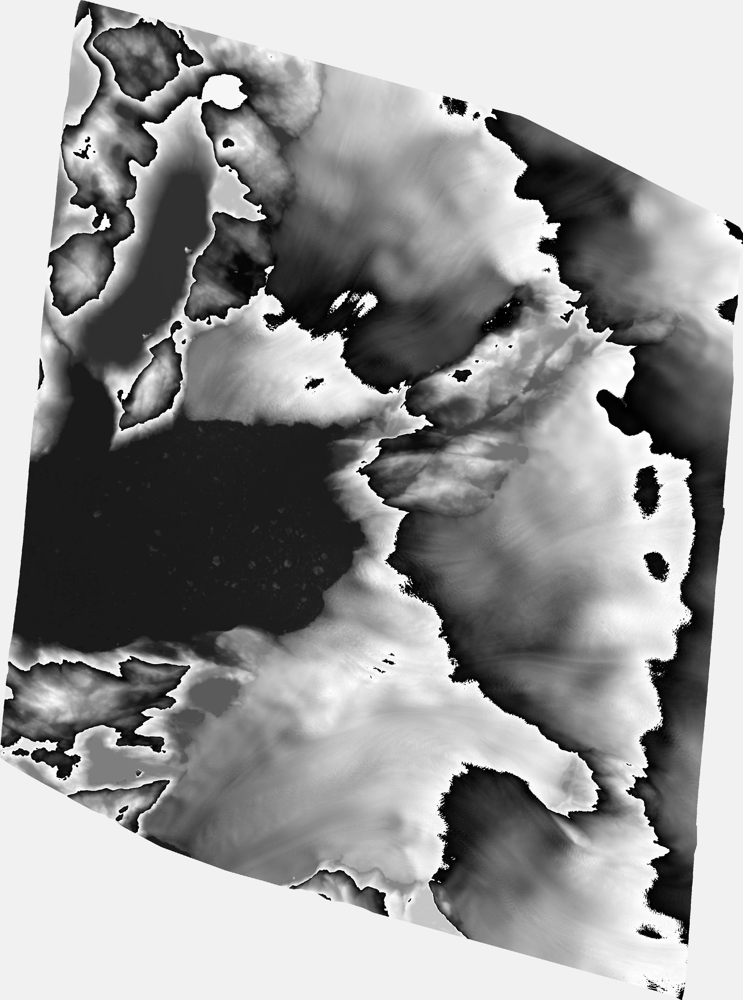
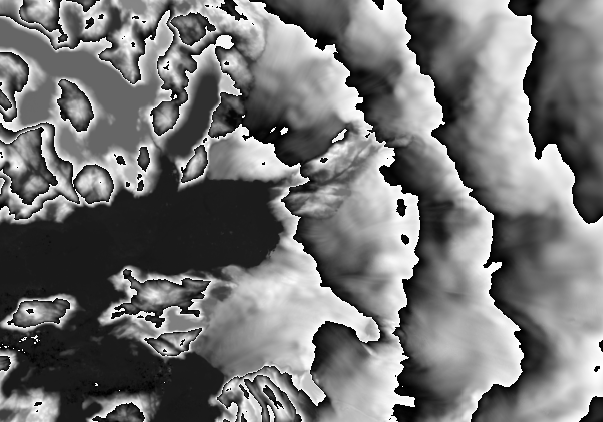

In [5]:
# Load the target DEM GeoTIFF file
with rasterio.open(target_dem_path) as src:
    target_dem_array = src.read(1, masked=True)  # Read the first band and handle nodata values
    target_bounds = src.bounds
    
    # Convert bounds to latitude and longitude coordinates
    target_min_lon, target_min_lat, target_max_lon, target_max_lat = transform_bounds(src.crs, "EPSG:4326", *src.bounds)
    
    # Convert the image data to a PIL Image object
    target_dem_image = Image.fromarray(target_dem_array.data.astype('uint8'))
    
    # Set zero values to nodata
    target_dem_array.data[target_dem_array.data == 0] = np.nan
    
    # Save the PIL Image as a PNG file
    target_dem_image.save('outputs/target_dem.png')

# Load the reference DEM GeoTIFF file
with rasterio.open(reference_dem_path) as src:
    reference_dem_array = src.read(1, masked=True)  # Read the first band and handle nodata values
    reference_bounds = src.bounds
    
    # Convert bounds to latitude and longitude coordinates
    reference_min_lon, reference_min_lat, reference_max_lon, reference_max_lat = transform_bounds(src.crs, "EPSG:4326", *src.bounds)
    
    # Convert the image data to a PIL Image object
    reference_dem_image = Image.fromarray(reference_dem_array.data.astype('uint8'))
    
    # Set zero values to nodata
    reference_dem_array.data[reference_dem_array.data == 0] = np.nan
    
    # Save the PIL Image as a PNG file
    reference_dem_image.save('outputs/reference_dem.png')

# Create a Folium map centered at some location with an Earth basemap
m = folium.Map(location=[(target_min_lat + target_max_lat) / 2, (target_min_lon + target_max_lon) / 2], zoom_start=7, tiles='OpenTopoMap')

# Overlay the target DEM image onto the map as a separate layer
folium.raster_layers.ImageOverlay(
    image='outputs/target_dem.png',
    bounds=[[target_min_lat, target_min_lon], [target_max_lat, target_max_lon]],
    mask=True,
    opacity=0.5  # Adjust opacity as needed
).add_to(m)

# Overlay the reference DEM image onto the map as a separate layer
folium.raster_layers.ImageOverlay(
    image='outputs/reference_dem.png',
    bounds=[[reference_min_lat, reference_min_lon], [reference_max_lat, reference_max_lon]],
    mask=True,
    opacity=0.7  # Adjust opacity as needed
).add_to(m)

# Add Layer Control to toggle visibility
folium.LayerControl().add_to(m)

# Display the map
m


Check differences in pixel resolution, coordinate system, ad transforations.


In [6]:
# Open the DEMs to reflect their differences
reference_dem_path  = 'DEM/TDX_Greenland_Iceland_Mosaic_90m_Sample.tif'
target_dem_path  = 'DEM/SETSM_s2s041_WV02_20150402_103001003E9F4300_103001004013BE00_2m_seg2_dem_10m.tif'

with rasterio.open(target_dem_path) as dem1_src, rasterio.open(reference_dem_path) as dem2_src:
    # Pixel resolution for DEMs
    x_res1, y_res1 = dem1_src.res
    x_res2, y_res2 = dem2_src.res

    # Coordinate system for DEMs
    crs1 = dem1_src.crs
    crs2 = dem2_src.crs

    # Transformation matrix for DEMs
    transform1 = dem1_src.transform
    transform2 = dem2_src.transform
    
    # DEMs' Bounds
    bounds1 = dem1_src.bounds
    bounds2 = dem2_src.bounds

# Create a table
table = [
    ["", "Pixel Resolution (x, y)", "Coordinate System", "Transformation Matrix"],
    ["Target DEM", (x_res1, y_res1), crs1, transform1],
    ["Reference DEM", (x_res2, y_res2), crs2, transform2]
]

# Print the table
print(tabulate(table, headers="firstrow"))


               Pixel Resolution (x, y)                 Coordinate System    Transformation Matrix
-------------  --------------------------------------  -------------------  --------------------------
Target DEM     (10.0, 10.0)                            EPSG:6053            | 10.00, 0.06,-198726.78|
                                                                            | 0.06,-10.00,-2158278.76|
                                                                            | 0.00, 0.00, 1.00|
Reference DEM  (89.87865543448117, 89.87700637328766)  EPSG:3413            | 89.88, 0.00,-223728.98|
                                                                            | 0.00,-89.88,-2156638.42|
                                                                            | 0.00, 0.00, 1.00|


# Explore Initial Alignment:

Display the two DEMs to observe the misalignment.



In [7]:
# Function to read and display a raster file
def read_and_display_dem(file_path, title, ax=None):
    with rasterio.open(file_path) as src:
        data = src.read(1, masked=True)
        if ax is None:
            fig, ax = plt.subplots()
        show(data, title=title, cmap='terrain', ax=ax)

# Function to read raster file
def read_dem(file_path):
    with rasterio.open(file_path) as src:
        return src.read(1, masked=True), src.meta


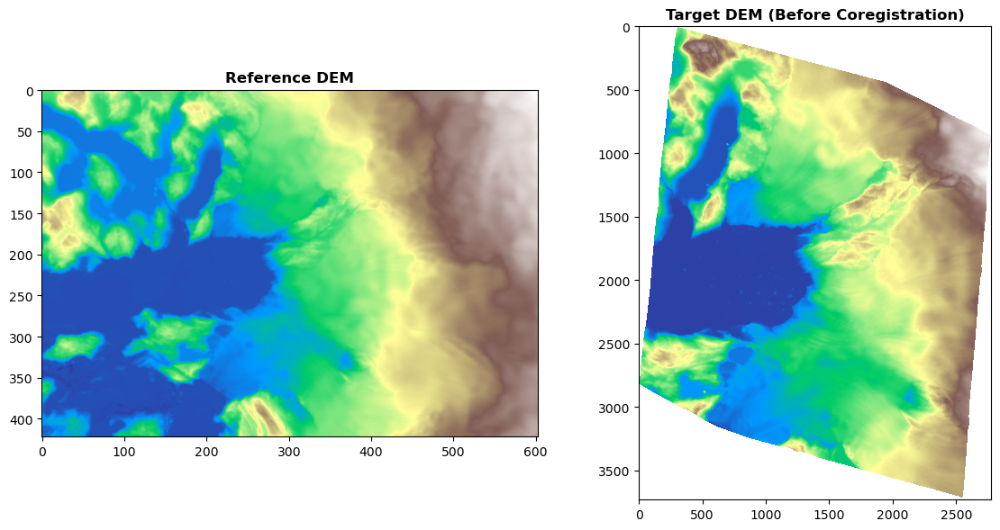

In [8]:
# Read and display
fig, axes = plt.subplots(1, 2, figsize=(12, 6))

# Read and display the reference DEM and the target DEM before coregistration
read_and_display_dem(reference_dem_path, title='Reference DEM', ax=axes[0])
read_and_display_dem(target_dem_path, title='Target DEM (Before Coregistration)', ax=axes[1])

# Show the plot
plt.tight_layout()
plt.show()


# Coregister one DEM to the other Using Resampling Approach
Coregistration requires that cell centroids align perfectly for all intersecting areas. Resampling is also extremely common during reprojection operations as it often requires changing the orientation, scale or resolution of an image.
<div><center>
<img src="img/Resampling1.png" width="800"/>
</div>

> <span style="color:gray">
    image source: wikicommons </span> 



# Aligning Cells through a Code Function 
The below function opens the reference DEM (match) to obtain its Coordinate Reference System (CRS), stored as dst_crs. Utilizing this information, the function calculates the output transformation matrix (dst_transform), width, and height to align with the reference DEM's shape and projection. Subsequently, properties for the output raster (dst_kwargs) are configured based on the target DEM properties, but with the updated CRS and transformation.

Depending on the chosen resampling method (method), the function iterates through each band of the target DEM, reprojects the data using either nearest neighbor or bilinear resampling, and writes it to the output raster accordingly. Finally, the output raster is saved to the specified output file (outfile) using rasterio.open() in write mode.



In [9]:
#Reproject a raster dem to match the shape and projection of a refrence raster dem: 
def coregister_rasters(infile, match, outfile, method):
        # Open the input raster (target dem)
    with rasterio.open(infile) as src:
        src_transform = src.transform
        
        # # Open the input raster to match (reference dem)
        with rasterio.open(match) as match:
            dst_crs = match.crs
            
            # calculate the output transform matrix to align the input raster with the matching raster
            dst_transform, dst_width, dst_height = calculate_default_transform(
                src.crs,     # input CRS
                dst_crs,     # output CRS
                match.width,   # input width
                match.height,  # input height 
                *match.bounds,  # unpacks input outer boundaries (left, bottom, right, top)
            )

        # set properties for output
        dst_kwargs = src.meta.copy()
        dst_kwargs.update({"crs": dst_crs,
                           "transform": dst_transform,
                           "width": dst_width,
                           "height": dst_height,
                           "nodata": 0})
        # Print information about the coregistration process
        print("Coregistered to shape:", dst_height,dst_width,'\n Affine:\n',dst_transform)
        
        # open output
        if method == 'nearest':
            # If nearest neighbor resampling method is chosen
            with rasterio.open(outfile, "w", **dst_kwargs) as dst:
                # iterate through bands and write using reproject function
                for i in range(1, src.count + 1):
                    reproject(
                        source=rasterio.band(src, i),
                        destination=rasterio.band(dst, i),
                        src_transform=src.transform,
                        src_crs=src.crs,
                        dst_transform=dst_transform,
                        dst_crs=dst_crs,
                        resampling=Resampling.nearest)
  
        elif method == 'bilinear':
            # If bilinear resampling method is chosen
            with rasterio.open(outfile, "w", **dst_kwargs) as dst:
                # iterate through bands and write using reproject function
                for i in range(1, src.count + 1):
                    reproject(
                        source=rasterio.band(src, i),
                        destination=rasterio.band(dst, i),
                        src_transform=src.transform,
                        src_crs=src.crs,
                        dst_transform=dst_transform,
                        dst_crs=dst_crs,
                        resampling=Resampling.bilinear)
        elif method == 'cubic':
             # If bilinear resampling method is chosen
             with rasterio.open(outfile, "w", **dst_kwargs) as dst:
                 # iterate through bands and write using reproject function
                 for i in range(1, src.count + 1):
                     reproject(
                         source=rasterio.band(src, i),
                         destination=rasterio.band(dst, i),
                         src_transform=src.transform,
                         src_crs=src.crs,
                         dst_transform=dst_transform,
                         dst_crs=dst_crs,
                         resampling=Resampling.cubic)
                

## Nearest Neighbour Method:
Nearest Neighbour is a techniquefor resampling raster data in which the value of each cell in an output raster is calculated using the value of the nearest cell in an input raster.
<br>
<br>
<div><center>
<img src="img/nearest-neighbor-300x104.png" width="400"/>
</div>

> <span style="color:gray">
    image source: GISGeography </span> 

Coregistered to shape: 641 726 
 Affine:
 | 93.75, 0.00,-30511338.88|
| 0.00,-93.75, 6697161.48|
| 0.00, 0.00, 1.00|


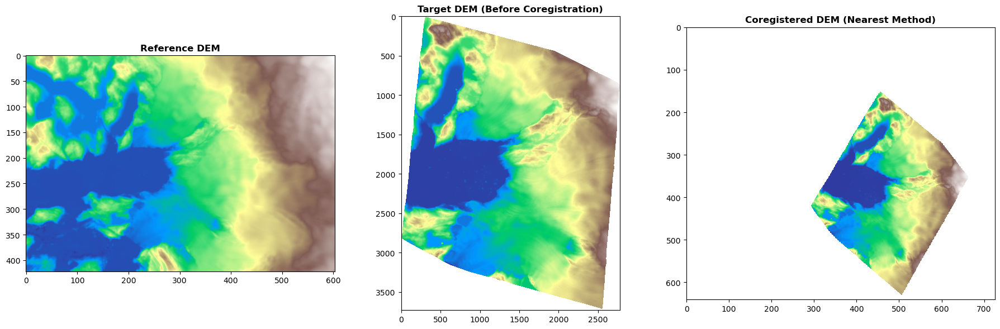

In [10]:
# Coregistered Output file
coregistered_dem_path = 'outputs/coregistered_nearest.tif'

# Co-register DEMs
coregister_rasters(target_dem_path, reference_dem_path, coregistered_dem_path, 'nearest')

# Display results
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Read and display reference DEM and target DEM before and coregistration DEM
read_and_display_dem(reference_dem_path, title='Reference DEM', ax=axes[0])
read_and_display_dem(target_dem_path, title='Target DEM (Before Coregistration)', ax=axes[1])
read_and_display_dem(coregistered_dem_path, title='Coregistered DEM (Nearest Method)', ax=axes[2])

# Show the plot
plt.tight_layout()
plt.show()

## Bilinear Interpolation Method:
Bilinear interpolation is a technique for calculating values of a grid location based on nearby grid cells. The key difference is that it uses the FOUR closest cell centers.

Using the four nearest neighboring cells, bilinear interpolation assigns the output cell value by taking the weighted average. It applies weights based on the distance of the four nearest cell centers smoothing the output raster grid.
<br>
<br>
<div><center>
<img src="img/bilinear-interpolation-425x143.png" width="400"/>
</div>

> <span style="color:gray">
    image source: GISGeography </span> 

Coregistered to shape: 641 726 
 Affine:
 | 93.75, 0.00,-30511338.88|
| 0.00,-93.75, 6697161.48|
| 0.00, 0.00, 1.00|


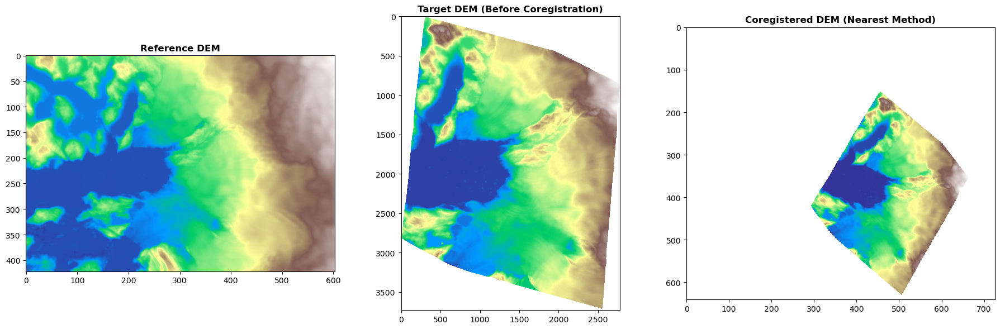

In [11]:
# Coregistered Output file
coregistered_dem_path = 'outputs/coregistered_bilinear.tif'

# Co-register DEMs
coregister_rasters(target_dem_path, reference_dem_path, coregistered_dem_path, 'bilinear')

# Display results
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Read and display reference DEM and target DEM before and coregistration DEM
read_and_display_dem(reference_dem_path, title='Reference DEM', ax=axes[0])
read_and_display_dem(target_dem_path, title='Target DEM (Before Coregistration)', ax=axes[1])
read_and_display_dem(coregistered_dem_path, title='Coregistered DEM (Nearest Method)', ax=axes[2])

# Show the plot
plt.tight_layout()
plt.show()

## Cubic Convolution Interpolation Method:
It works a bit like bilinear interpolation – it looks at nearby cells to figure out the value. But here's the twist: instead of just four cells, it checks out the average of 16 nearby cells. This means it takes a bit longer to process. People usually use this method when dealing with continuous surfaces that have a lot of noise. Since it looks at more neighboring cells than bilinear resampling, it's great for smoothing out data from the input raster grid.
<br>
<br>
<div><center>
<img src="img/cubic-convolution-300x101.png" width="400"/>
</div>

> <span style="color:gray">
    image source: GISGeography </span> 

Coregistered to shape: 641 726 
 Affine:
 | 93.75, 0.00,-30511338.88|
| 0.00,-93.75, 6697161.48|
| 0.00, 0.00, 1.00|


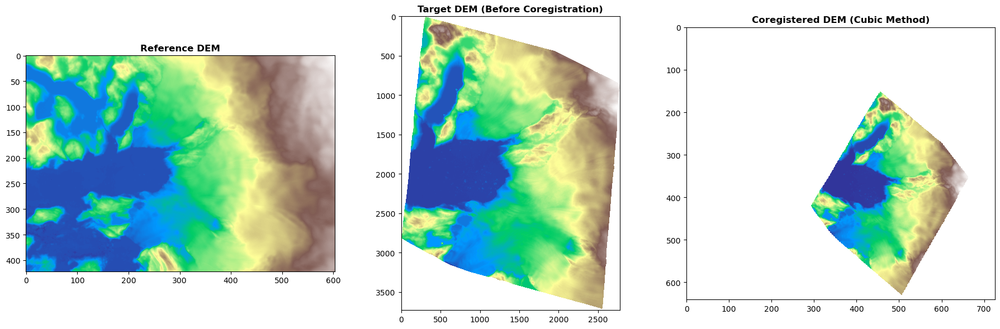

In [12]:
# Coregistered Output file
coregistered_dem_path = 'outputs/coregistered_cubic.tif'

# Co-register DEMs
coregister_rasters(target_dem_path, reference_dem_path, coregistered_dem_path, 'cubic')

# Display results
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Read and display reference DEM and target DEM before and coregistration DEM
read_and_display_dem(reference_dem_path, title='Reference DEM', ax=axes[0])
read_and_display_dem(target_dem_path, title='Target DEM (Before Coregistration)', ax=axes[1])
read_and_display_dem(coregistered_dem_path, title='Coregistered DEM (Cubic Method)', ax=axes[2])

# Show the plot
plt.tight_layout()
plt.show()

# 3D Visualization? 

Display the coregistered DEM.

In [13]:
import rasterio
import plotly.graph_objs as go

# Read the DEMs
coregistered_dem_data, meta = read_dem(coregistered_dem_path)
# Create surface plots for each DEM
coregistered_surface = go.Surface(z=coregistered_dem_data, colorscale='earth', name='Coregistered DEM')

# Create figure
fig = go.Figure(data=[coregistered_surface])
# Update layout
fig.update_layout(title='3D DEMs', scene=dict(aspectmode='data'))
# Show plot
fig.show()


# Saving Coregistered DEM:

Save the coregistered DEM for future use.

+-----------+-----------------------------+
|           | metadata                    |
+===========+=============================+
| driver    | GTiff                       |
+-----------+-----------------------------+
| dtype     | float32                     |
+-----------+-----------------------------+
| nodata    | 0.0                         |
+-----------+-----------------------------+
| width     | 726                         |
+-----------+-----------------------------+
| height    | 641                         |
+-----------+-----------------------------+
| count     | 1                           |
+-----------+-----------------------------+
| crs       | EPSG:3413                   |
+-----------+-----------------------------+
| transform | | 93.75, 0.00,-30511338.88| |
|           | | 0.00,-93.75, 6697161.48|  |
|           | | 0.00, 0.00, 1.00|         |
+-----------+-----------------------------+


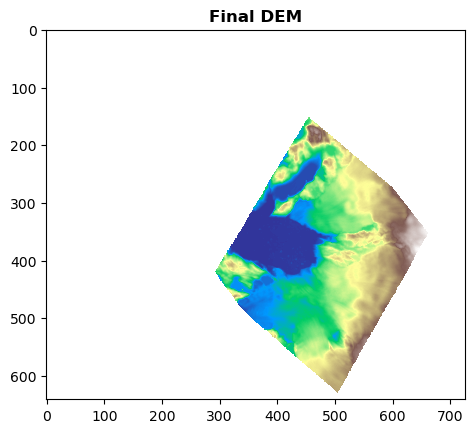

In [14]:
#Define saving parameters such as folder path, format, coordinate system, etc.
coregistered_dem_data, coregistered_dem_metadata  = read_dem(coregistered_dem_path)
output_path = 'outputs/coregistered_dem_final.tif'

#Saving function
def save_coregistered_dem(coregistered_dem_data,  output_path):
    # Define the metadata for the output GeoTIFF file
    height, width = coregistered_dem_data.shape
    dtype = coregistered_dem_data.dtype
    nodata_value = 0  
    # Writing the coregistered DEM data to a GeoTIFF file
    with rasterio.open(output_path, 'w', **coregistered_dem_metadata) as dst:
        dst.write(coregistered_dem_data, 1)

# Save the coregistered DEM data
save_coregistered_dem(coregistered_dem_data,  output_path)

# Check the result
metadata_table = [[key, value] for key, value in coregistered_dem_metadata.items()]
# Print the metadata
print(tabulate(metadata_table, headers=['metadata'], tablefmt='grid'))
# Display the result
read_and_display_dem(output_path, title='Final DEM')



# Advanced Method:

Coregister efficiently with one coding cell, using **xDEM** package built-in tools:
https://xdem.readthedocs.io/en/latest/about_xdem.html

In [15]:
import xdem

# Set the paths to the target and reference DEMs
target_dem_path = 'DEM/SETSM_s2s041_WV02_20150402_103001003E9F4300_103001004013BE00_2m_seg1_dem_10m.tif'
reference_dem_path  = 'DEM/TDX_Greenland_Iceland_Mosaic_90m_Sample.tif'

# Load the reference DEM
reference_dem = xdem.DEM(reference_dem_path)

# Load and reproject the target DEM to match the reference DEM
dem_to_be_aligned = xdem.DEM(target_dem_path).reproject(reference_dem, silent=True)

# Initialize the NuthKaab coregistration method
nuth_kaab = xdem.coreg.NuthKaab()

# Fit the data to a suitable x/y/z offset
nuth_kaab.fit(reference_dem.data, dem_to_be_aligned.data, transform=reference_dem.transform, crs=reference_dem.crs)

# Apply the coregistration to align the target DEM to the reference DEM
aligned_dem = nuth_kaab.apply(dem_to_be_aligned)

# Save the aligned DEM
aligned_dem.save("outputs/coregistered_NuthKaab.tif")


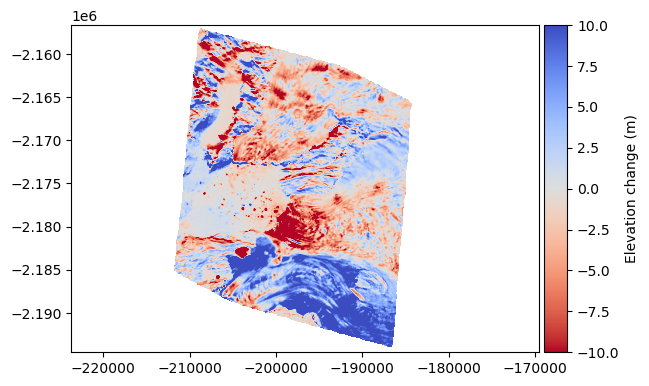

In [16]:
# Calculate the difference after coregistration
diff_after = reference_dem - aligned_dem

# Show the difference using a colormap
diff_after.show(cmap="coolwarm_r", vmin=-10, vmax=10, cbar_title="Elevation change (m)")

# Next Lesson: Differening for Change Detection Exercise

Thank you!